In [51]:
import os
import urllib.request
import json
import sys
import requests
import tarfile
import numpy as np
from PIL import Image
import PIL.Image

from PIL import ImageFont, ImageDraw
from IPython.display import display, Image

from matplotlib import pyplot as plt
import shutil
import cv2 as cv
%matplotlib inline

In [2]:
def get_archive(path,url,Set):
  try:
    os.mkdir(path)
  except:
    path=path

  urllib.request.urlretrieve(url,f"{path}/{Set}.tar")

# get_archive('/con?tent','https://dax-cdn.cdn.appdomain.cloud/dax-publaynet/1.0.0/val.tar.gz')
get_archive('/content','https://dax-cdn.cdn.appdomain.cloud/dax-publaynet/1.0.0/labels.tar.gz?_ga=2.118089353.1003780486.1651407686-582419743.1648145310',"label")
get_archive('/content','https://dax-cdn.cdn.appdomain.cloud/dax-publaynet/1.0.0/train-0.tar.gz?_ga=2.184599081.1003780486.1651407686-582419743.1648145310',"train")

In [34]:

def extract_tar(Set):
  my_tar = tarfile.open(f'./{Set}.tar')
  my_tar.extractall(f'./{Set}') # specify which folder to extract to
  my_tar.close()

In [6]:
extract_tar("train")
extract_tar("label")


In [35]:
def get_data_and_annots():
  images={}
  with open('label/publaynet/train.json') as t:
    data=json.load(t)

  for train_images in os.walk('train/publaynet/train'):
    train_imgs = train_images[2]

  for image in data['images']:
    if image['file_name'] in train_imgs:
      images[image['id']] = {'file_name': "train/publaynet/train/" + image['file_name'], 'annotations': []}
    if len(images) == 500:
      break

  for ann in data['annotations']:
    if ann['image_id'] in images.keys():
      images[ann['image_id']]['annotations'].append(ann)
  return images,data

In [ ]:
images,data = get_data_and_annots()

In [12]:
def markup(samples,image, annotations):
    ''' Draws the segmentation, bounding box, and label of each annotation
    '''
    draw = ImageDraw.Draw(image, 'RGBA')
    for annotation in annotations:
        # Draw segmentation
        draw.polygon(annotation['segmentation'][0],
                     fill=colors[samples['categories'][annotation['category_id'] - 1]['name']] + (64,))
        # Draw bbox
        draw.rectangle(
            (annotation['bbox'][0],
             annotation['bbox'][1],
             annotation['bbox'][0] + annotation['bbox'][2],
             annotation['bbox'][1] + annotation['bbox'][3]),
            outline=colors[data['categories'][annotation['category_id'] - 1]['name']] + (255,),
            width=2
        )
        # Draw label
        w, h = draw.textsize(text=samples['categories'][annotation['category_id'] - 1]['name']
                             )
        if annotation['bbox'][3] < h:
            draw.rectangle(
                (annotation['bbox'][0] + annotation['bbox'][2],
                 annotation['bbox'][1],
                 annotation['bbox'][0] + annotation['bbox'][2] + w,
                 annotation['bbox'][1] + h),
                fill=(64, 64, 64, 255)
            )
            draw.text(
                (annotation['bbox'][0] + annotation['bbox'][2],
                 annotation['bbox'][1]),
                text=samples['categories'][annotation['category_id'] - 1]['name'],
                fill=(255, 255, 255, 255)
            )
        else:
            draw.rectangle(
                (annotation['bbox'][0],
                 annotation['bbox'][1],
                 annotation['bbox'][0] + w,
                 annotation['bbox'][1] + h),
                fill=(64, 64, 64, 255)
            )
            draw.text(
                (annotation['bbox'][0],
                 annotation['bbox'][1]),
                text=samples['categories'][annotation['category_id'] - 1]['name'],
                fill=(255, 255, 255, 255)

            )
    return np.array(image)
# Define color code
colors = {'title': (255, 0, 0),
          'text': (0, 255, 0),
          'figure': (0, 0, 255),
          'table': (255, 255, 0),
          'list': (0, 255, 255)}

<ipython-input-12-3cf2d99f6191>:19: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  w, h = draw.textsize(text=samples['categories'][annotation['category_id'] - 1]['name']
<ipython-input-12-3cf2d99f6191>:19: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  w, h = draw.textsize(text=samples['categories'][annotation['category_id'] - 1]['name']
<ipython-input-12-3cf2d99f6191>:19: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  w, h = draw.textsize(text=samples['categories'][annotation['category_id'] - 1]['name']
<ipython-input-12-3cf2d99f6191>:19: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  w, h = draw.textsize(text=samples['categories'][annotation['category_id'] - 1]['nam

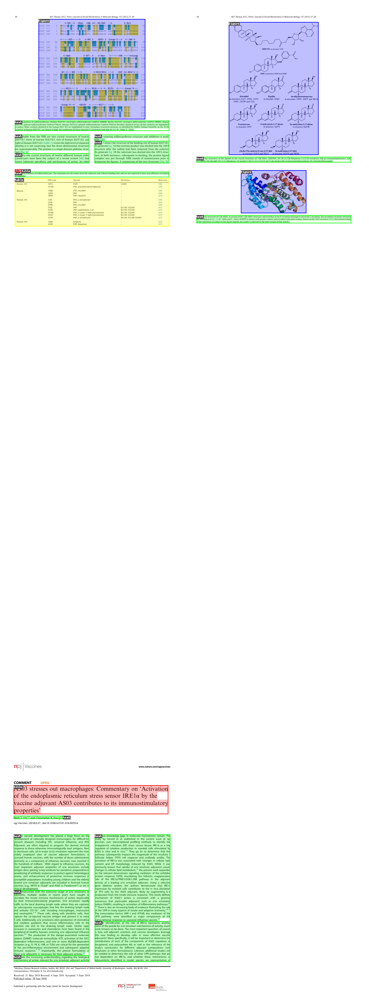

In [13]:
# font = ImageFont.truetype("examples/DejaVuSans.ttf", 15)
import matplotlib.pyplot as plt
fig=plt.figure(figsize=(16, 100))
for i in range(3):
  _, image =list(images.items())[i]
  with Image.open(image['file_name']) as img:
    ax = plt.subplot(3, 2, i + 1)
    ax.imshow(markup(data,img, image['annotations']))
    ax.axis('off')

plt.subplots_adjust(hspace=0, wspace=0)


In [42]:
class GenerateYoloLabels:
  def __init__(self,images):
    self.check_set=set()
    self.images=images

  def write_file(self,image_id,inside,filename,content):
    if inside:
      file = open(filename,"a")
      file.write("\n")
      file.write(content)
      file.close()
    if not inside:
      self.check_set.add(image_id)
      file = open(filename,"w")
      file.write(content)
      file.close()

  def get_bb_shape(self,bboxe,img):
    tleft = (bboxe[0],bboxe[1])
    tright= (bboxe[0]+bboxe[2],bboxe[1])
    bleft =(bboxe[0],bboxe[1]+bboxe[3])
    bright = (bboxe[0]+bboxe[2],bboxe[1]+bboxe[3])

    top_left_x = min([tleft[0],tright[0],bleft[0],bright[0]])
    top_left_y = min([tleft[1],tright[1],bleft[1],bright[1]])
    bot_right_x = max([tleft[0],tright[0],bleft[0],bright[0]])
    bot_right_y = max([tleft[1],tright[1],bleft[1],bright[1]])

    image = img[int(top_left_y):int(bot_right_y)+1, int(top_left_x):int(bot_right_x)+1]

    return image.shape[:2]

  def coco_to_yolo(self,x1, y1, w, h, image_w, image_h):
    return [((2*x1 + w)/(2*image_w)) , ((2*y1 + h)/(2*image_h)), w/image_w, h/image_h]

  def generate(self):
    os.mkdir("yolo")
    for key in self.images.keys():
      image_id = ','.join(map(str,[image_id['image_id'] for image_id in self.images[key]['annotations']]))
      category_id =''.join(map(str,[cat_id['category_id']-1 for cat_id in self.images[key]['annotations']]))
      bbox= [bbox['bbox'] for bbox in self.images[key]['annotations']]
      image_path = self.images[key]['file_name']
      filename = 'yolo/' + image_path.split('/')[3].split(".")[0] + '.txt'

      for index,b in enumerate(bbox):
        bbox =[b[0],b[1],b[2],b[3]]
        shape = self.get_bb_shape(bbox,cv.imread(image_path))
        yolo_bbox = self.coco_to_yolo(bbox[0],bbox[1],shape[1],shape[0],cv.imread(image_path).shape[1],cv.imread(image_path).shape[0])
        content = category_id[index] + ' ' + str(yolo_bbox[0]) + ' ' + str(yolo_bbox[1]) + ' ' + str(yolo_bbox[2]) + ' ' + str(yolo_bbox[3])

        if image_id in self.check_set:
          self.write_file(image_id,True,filename,content)
        elif image_id not in self.check_set:
          self.write_file(image_id,False,filename,content)

    return "Done"

In [ ]:
generate_labels = GenerateYoloLabels(images)
generate_labels.generate()

In [32]:
class FinalPreparation:
  def __init__(self,old_train_path,temp_images_path,yolo_path,images):
    self.old_train_path = old_train_path
    self.temp_images_path = temp_images_path
    self.yolo_path =yolo_path
    self.images =images
    self.delete_additional_images()
    self.valid_without_extension = self.split_data()

  def delete_additional_images(self):
    for train in os.walk(self.old_train_path):
      print(train[2])
    for label in os.walk(self.yolo_path):
      print(label[2])
    os.mkdir("images")
    for img in train[2]:
      splited = img.split(".")[0]
      txt = f"{splited}.txt"
      if txt in label[2]:
        shutil.move(f"{self.old_train_path}/{img}",f"./{self.temp_images_path}/{img}")
    return "DOne"

  def split_data(self):
    for image in os.walk('./images/'):
      print("Images List")
    train = image[2][int(len(image[2]) * .1) : int(len(image[2]) * .90)]
    validation = list(set(image[2]) - set(train))
    os.mkdir("training")
    os.mkdir("validation")
    os.mkdir("training/images/")
    os.mkdir("validation/images/")
    for train_img in train:
      shutil.move(f'./{self.temp_images_path}/{train_img}', "training/images/")

    for valid_img in validation:
      shutil.move(f'./{self.temp_images_path}/{valid_img}', "validation/images/")
    validation_without_ext= [i.split('.')[0] for i in validation]

    return validation_without_ext

  def get_labels(self):
    os.mkdir("training/labels")
    os.mkdir("validation/labels")
    for label in os.walk(self.yolo_path):
      print("label List")
    for lab in label[2]:
      # print(lab)
      split=lab.split(".")[0]
      # print(split)
      if split in self.valid_without_extension:
      # print(split)
        shutil.move(f"{self.yolo_path}/{lab}",f"./validation/labels/{lab}")
      else:
        shutil.move(f"{self.yolo_path}/{lab}",f"./training/labels/{lab}")
    return "Done"


In [ ]:
finalPrep = FinalPreparation("./train/publaynet/train","images","./yolo",images)
finalPrep.get_labels()

In [47]:
!nvidia-smi

Mon Aug 21 09:24:58 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   41C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [35]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 609.6/609.6 kB 6.3 MB/s eta 0:00:00


In [7]:
from ultralytics import YOLO
from IPython.display import display, Image
from IPython import display
display.clear_output()

In [8]:
!yolo mode=checks

WARNING ⚠️ 'yolo mode=checks' is deprecated. Use 'yolo checks' instead.
Ultralytics YOLOv8.0.158 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 39.4/78.2 GB disk)


In [80]:
!yolo task=detect mode=train model=yolov8l.pt imgsz=640 data=config.yaml epochs=1 batch=8 name=yolov8l_custom


Ultralytics YOLOv8.0.158 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8l.pt, data=config.yaml, epochs=1, patience=50, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov8l_custom, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False, int8=False, dynam

In [68]:
def show_results(yolo_vers):
  img_path = f"/content/runs/detect/{yolo_vers}/val_batch2_pred.jpg"
  image = Image.open(img_path)
  display(image)


/content/runs/detect/yolov8n_custom4/val_batch2_pred.jpg


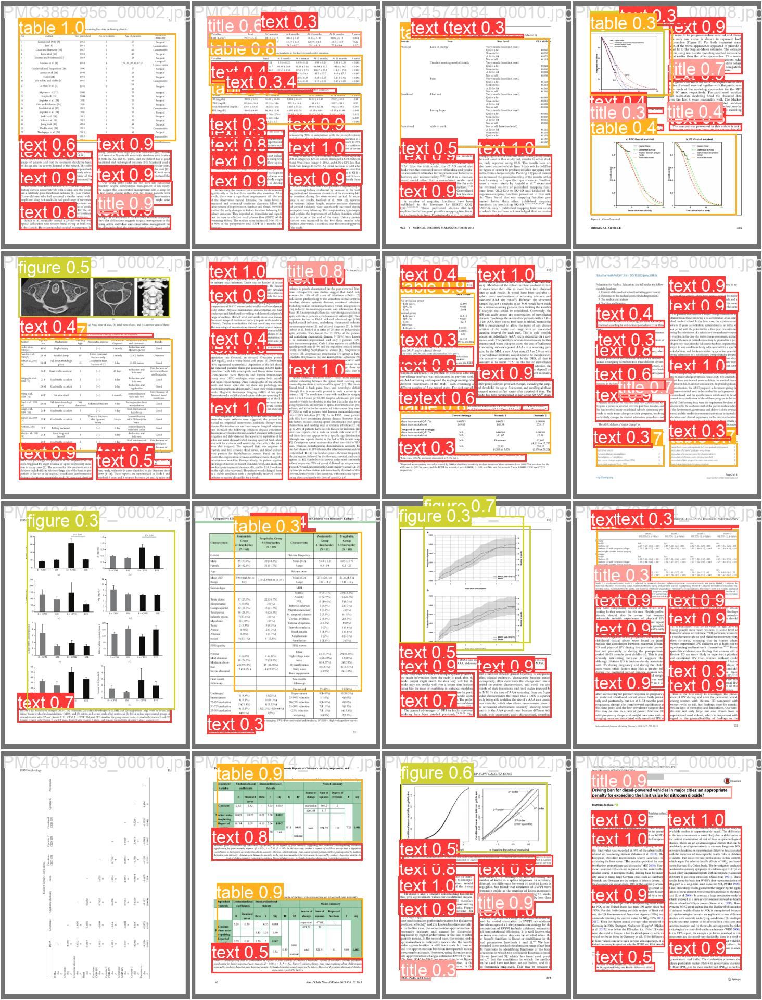

In [69]:
from PIL import Image

show_results("yolov8n_custom4")

/content/runs/detect/yolov8s_custom/val_batch2_pred.jpg


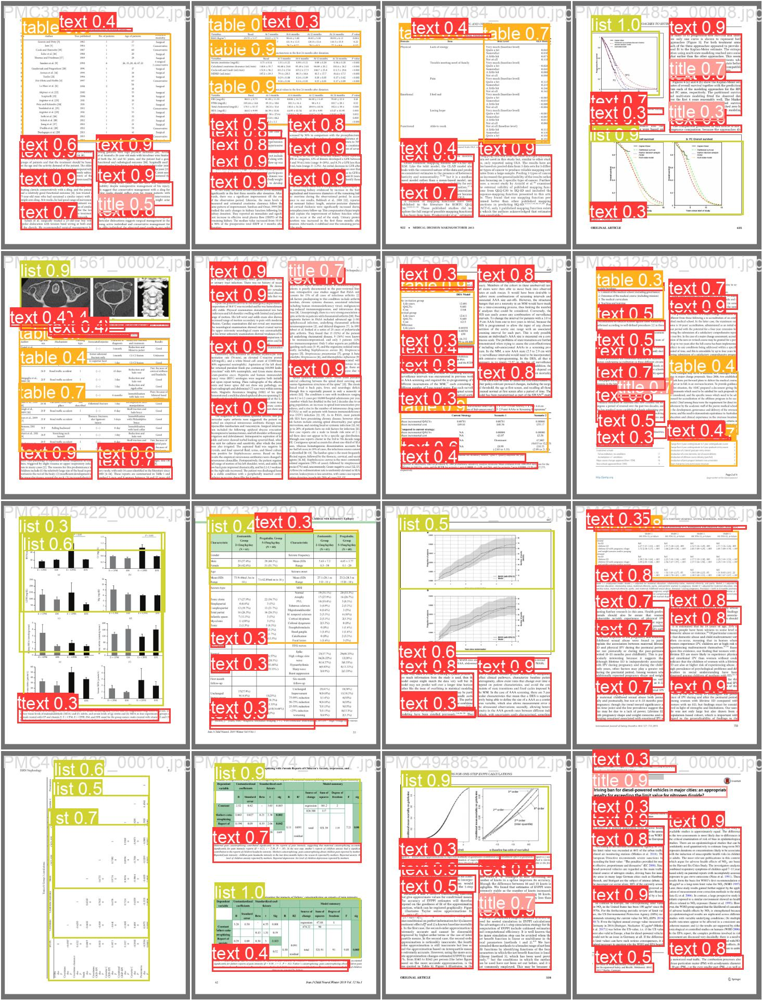

In [71]:
show_results("yolov8s_custom")


/content/runs/detect/yolov8l_custom/val_batch2_pred.jpg


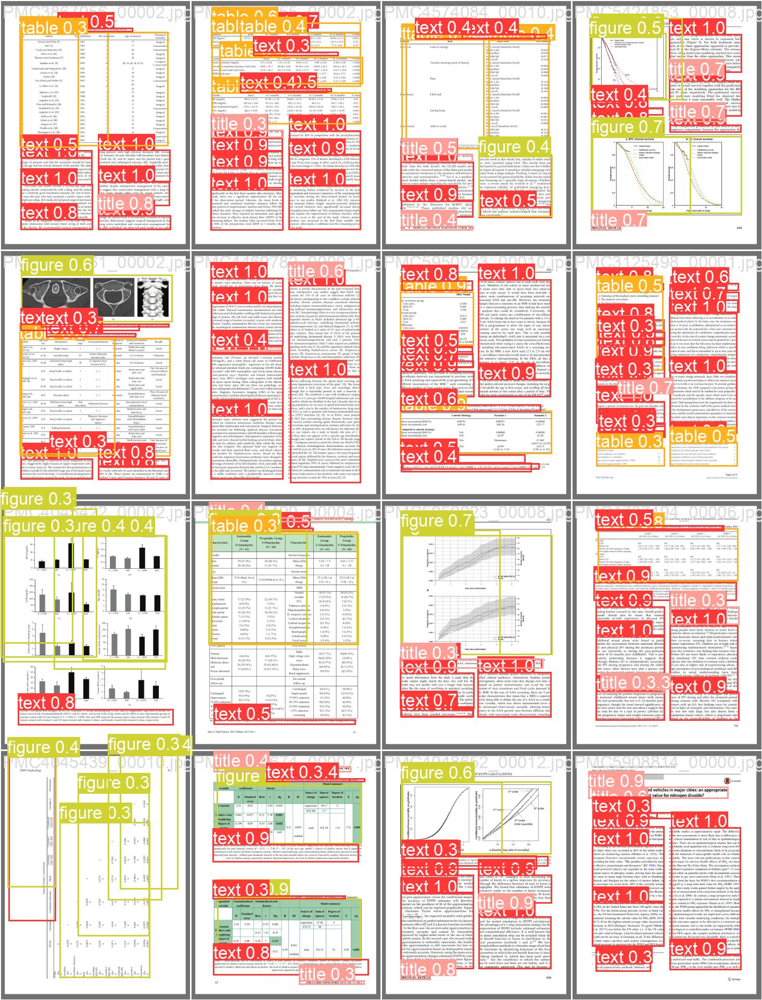

In [72]:
show_results("yolov8l_custom")

/content/runs/detect/yolov8m_custom/val_batch2_pred.jpg


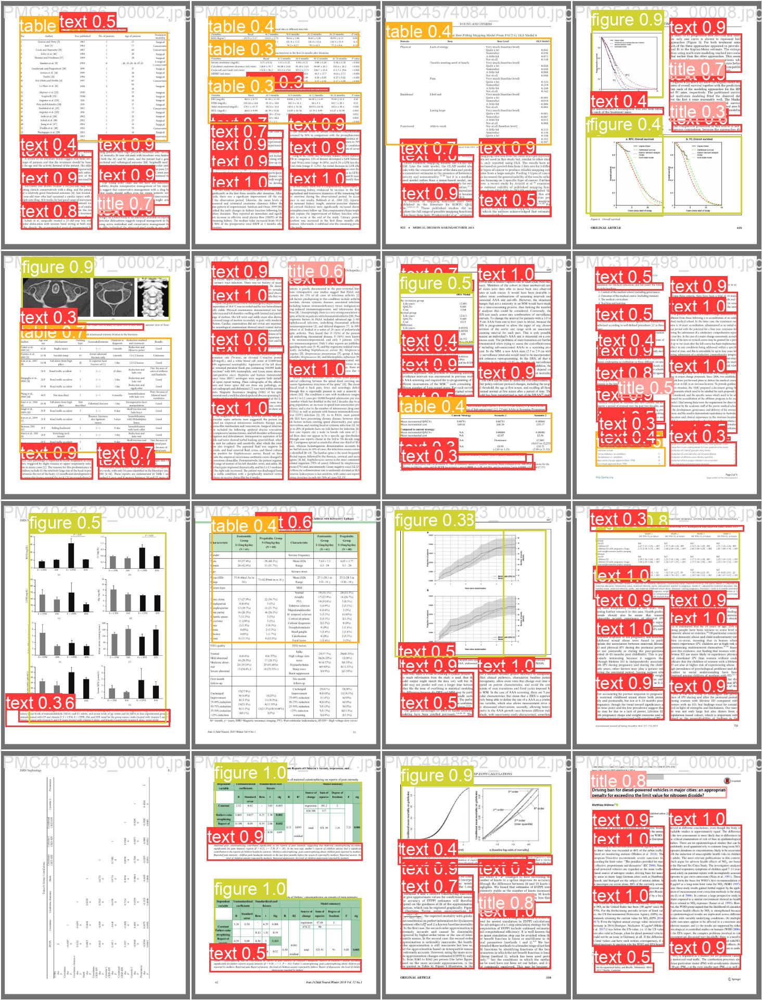

In [73]:
show_results("yolov8m_custom")

/content/runs/detect/yolov8n_custom3/val_batch2_pred.jpg


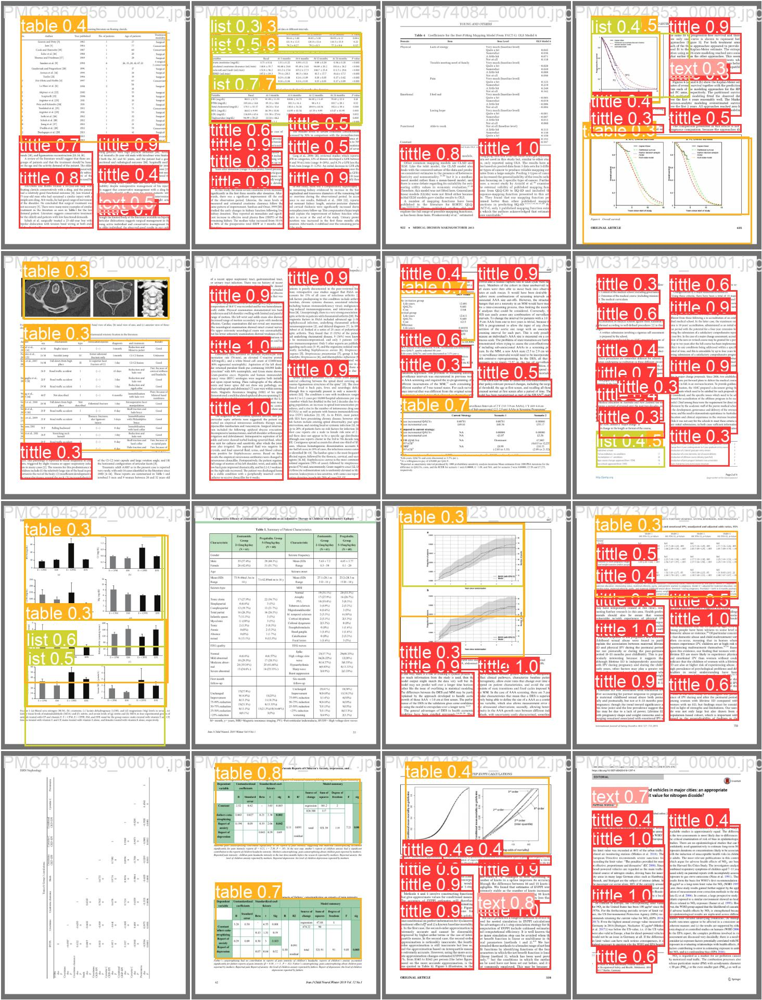

In [76]:
show_results("yolov8n_custom3")

/content/runs/detect/yolov8n_custom5/val_batch2_pred.jpg


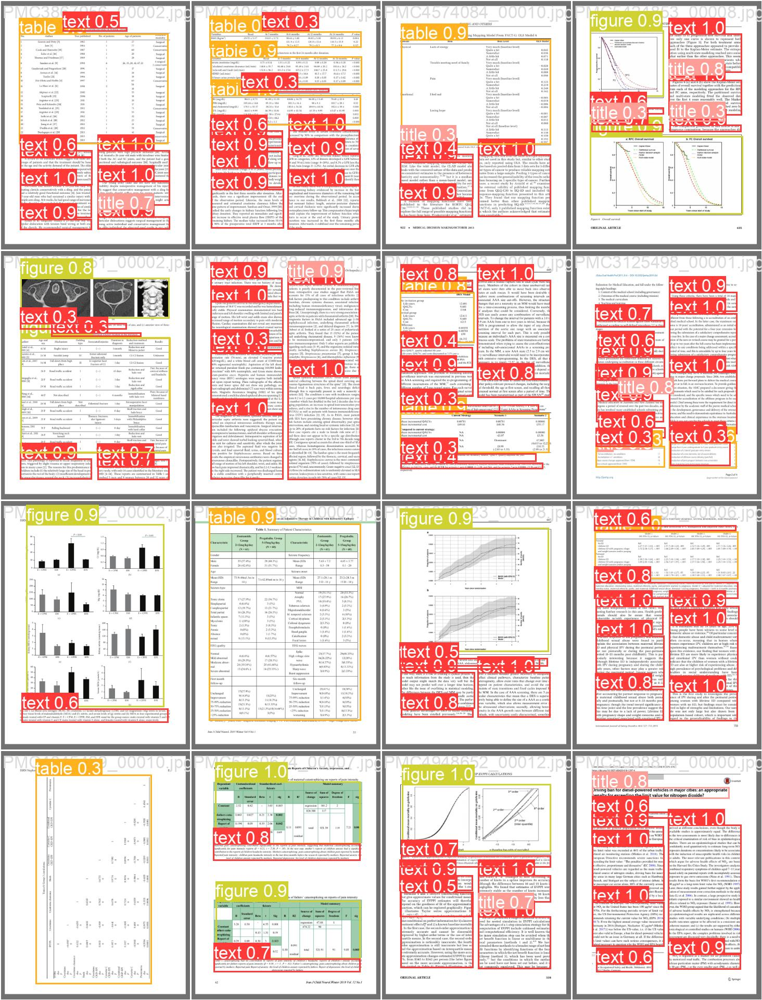

In [81]:
show_results("yolov8n_custom5")